# bitw0r1d overview

Bitw0r1d is a general framework for simulating the cultural evolution of technology (Winters & Charbonneau, 2025). Adopting a macroscopic approach, which aims to explain long-term patterns of change using a minimal set of endogenous macro-level properties (Enquist et al., 2011; Mesoudi, 2011), we model the dynamics of technological evolution in terms of two causally interacting processes: one that changes the structure of technological systems ($\mathbb{T}$) and one that changes the structure of the search space ($\mathbb{S}$). In this ipython notebook, I will run you through the basics of the model and how to run a simulation.

## Preliminaries

First of all, we are going to need to import the main python code for running bitw0r1d as well as some additional packages for plotting:

In [1]:
from bitw0r1d import *
import seaborn as sns; sns.set()
import matplotlib.pyplot as plt
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'pdf')

/var/folders/n_/0017cvfs1ng1yzx5bxr_cjlh0000gn/T/ipykernel_30113/1578438937.py:5: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg', 'pdf')


## Technological systems ($\mathbb{T}$) and search spaces ($\mathbb{S}$)

At the start of a simulation, a society is initialised with a technological system ($\mathbb{T}$) and a search space ($\mathbb{S}$). Both $\mathbb{T}$ and $\mathbb{S}$ are operationalised as bitstrings of $N$-length. Search spaces represent the aggregate collection of needs, problems and goals facing a society and determine what constitutes an effective system of technologies, whereas whereas technological systems represent the totality of skills, techniques, artifacts and knowledge used to exploit these search spaces.

Modelling $\mathbb{T}$ and $\mathbb{S}$ as bitstrings is useful in this respect because we can represent both technological systems and search spaces as structured entities. Structure refers to how the properties of $\mathbb{T}$ and the properties of $\mathbb{S}$ are organised. In bitw0r1d, this means bitstrings can both vary in the distribution of 0s and 1s (e.g., $0011$ versus $1010$) and in the length of the string (e.g., $0110$ versus $01101001$): 

In [3]:
T = string_generator(p=0.5,l=10)
S = string_generator(p=0.5,l=8)
print(f'Technological System: {T} \nSearch Space: {S}')

Technological System: 1111010110 
Search Space: 10010010


Taken together, these two properties allow us to measure the distance between $\mathbb{T}$ and $\mathbb{S}$, which we use to approximate effectiveness, $E(\mathbb{T},\mathbb{S})$, and the string length, which serves as a proxy for complexity, $C_\mathbb{T}$ and $C_\mathbb{S}$.

Effectiveness directly corresponds to the distance between $\mathbb{T}$ and $\mathbb{S}$. Formally, we measure effectiveness using the Levenshtein distance (Levenshtein, 1975). This tells us the minimum number of single-element edits (insertions, deletions or substitutions) required to transform one bitstring into another. We normalise and then invert this to give us a measure where $E(\mathbb{T},\mathbb{S})=1.0$ is an optimal outcome and $E(\mathbb{T},\mathbb{S})=0.0$ is a non-optimal one. Values of $E(\mathbb{T},\mathbb{S}) \in (0.0,1.0)$ represent suboptimal mappings. Using the $\mathbb{T}$ and $\mathbb{S}$ generated above, we calculate the effectiveness as follows:

In [4]:
print(f'The effectiveness is: {evaluate(T,S)}')

The effectiveness is: 0.6


The length of a bitstring is used to measure the complexity of both technological systems ($C_\mathbb{T}$) and search spaces ($C_\mathbb{S}$). Again, we can use the two strings we generated previously to show the complexity:

In [5]:
print(f'The complexity of the technological system is {len(T)} and the complexity of the search space is {len(S)}')

The complexity of the technological system is 10 and the complexity of the search space is 8


Restricting our definition of complexity to string length allows us to formulate it in terms of computational principles, i.e., the time required (on average) to find a maximally effective outcome given an initial state and an underlying process. Within the general constraints of our model, longer strings can be viewed as more complex than shorter ones because there are a greater number of possible configurations. Below, we demonstrate this basic point by modelling an optimization process where $\mathbb{S}$ is held as a fixed entity, but $\mathbb{T}$ is allowed to vary and follows a two-step process of generating and then adopting a change. 

### Optimization process

A change refers to either an insertion, deletion or flipping of bit. Try generating and adopting a change using the following function:

In [46]:
T = '0110'
S = '1111'
change = string_edit(str_1=T, str_2=S, eff=1.0)
print(f'Original: {T}   New: {change}')

Original: 0110   New: 0111


You'll probably find it takes a few clicks to actually generate a noticeable difference. This is because we set the `eff` parameter to `1.0`, which means a change is only adopted if it improves effectiveness (otherwise remain with current $\mathbb{T}$). On the otherhand, if you'd set `eff=0.0` then a change is always adopted irrespective of whether or not it improves effectiveness: 

In [47]:
T = '0110'
S = '1111'
change = string_edit(str_1=T, str_2=S, eff=0.0)
print(f'Original: {T}   New: {change}')

Original: 0110   New: 01101


Now that we have the basic understanding of this function, we will incorporate it into a general model of optimization. First, we need to create a function to write a dataframe for our output:

In [8]:
def df_out(data:list) -> pd.DataFrame:
	"""
	Produces a pandas dataframe for writing
	"""
	df = pd.DataFrame(data,columns=[
		'seed',
		'generation',
		'space_complexity',
		'space_prob',
		'initial_tech_complexity',
		'tech_prob',
		'tech_complexity',
		'effectiveness'
		])
	return df

Next, we write an optimization function:

In [11]:
def optimization(printing:bool,seed:int,generations:int,s_length:int,s_prob:float,t_length:int,t_prob:float,η:float) -> pd.DataFrame:
	# Set random seeds
	np.random.seed(seed)
	rn.seed(seed)
	# Specify empty output list to store data
	output = []
	# Setting probabilities for initial technological system and search space
	if s_prob is None and t_prob is None:
		s_prob = np.random.uniform(low=0.0,high=1.0,size=None)
		t_prob = np.random.uniform(low=0.0,high=1.0,size=None)
	elif s_prob is None:
		s_prob = np.random.uniform(low=0.0,high=1.0,size=None)
	elif t_prob is None:
		t_prob = np.random.uniform(low=0.0,high=1.0,size=None)
	# Generating initial technological system and search space
	T = string_generator(p=t_prob,l=t_length)
	S = string_generator(p=s_prob,l=s_length)
	# Append initial generation to output
	output.append([seed,0,s_length,s_prob,t_length,t_prob,len(T),evaluate(T,S)])
	# Run optimization process for g generations
	for g in range(1,generations):
		# Generate change and adopt change
		T = string_edit(str_1=T, str_2=S, eff=η)
		effectiveness = evaluate(T,S)
		output.append([seed,g,s_length,s_prob,t_length,t_prob,len(T),effectiveness])
		if printing == True:
			print(f'Generation {g} has an Effectiveness of: {effectiveness}')
	df = df_out(data=output)
	return df

This function keeps $\mathbb{S}$ constant and makes changes to $\mathbb{T}$ over a finite number of generations ($g \in G$). The key manipulations here are to the complexity of the search space (`s_length`) and the complexity of the technological system (`t_length`). Below is an example where $C_\mathbb{S}=100$, $C_\mathbb{T}=2$, and $\eta=1.0$:

In [49]:
seed = seed_gen(samples=1)[0]
print(seed)
optimization(printing=False,seed=seed,generations=10000,s_length=100,s_prob=None,t_length=2,t_prob=None,η=1.0)

369488


/var/folders/n_/0017cvfs1ng1yzx5bxr_cjlh0000gn/T/ipykernel_30113/655631803.py:4: DeprecationWarning: Seeding based on hashing is deprecated
since Python 3.9 and will be removed in a subsequent version. The only 
supported seed types are: None, int, float, str, bytes, and bytearray.
  rn.seed(seed)


,seed,generation,space_complexity,space_prob,initial_tech_complexity,tech_prob,tech_complexity,effectiveness
0,369488,0,100,0.601637,2,0.423548,2,0.02
1,369488,1,100,0.601637,2,0.423548,3,0.03
2,369488,2,100,0.601637,2,0.423548,4,0.04
3,369488,3,100,0.601637,2,0.423548,4,0.04
4,369488,4,100,0.601637,2,0.423548,4,0.04
...,...,...,...,...,...,...,...,...
9995,369488,9995,100,0.601637,2,0.423548,100,1.00
9996,369488,9996,100,0.601637,2,0.423548,100,1.00
9997,369488,9997,100,0.601637,2,0.423548,100,1.00
9998,369488,9998,100,0.601637,2,0.423548,100,1.00


We see that for a $C_\mathbb{S}=100$ that an initial $C_\mathbb{T}=2$ reached an optimal outcome by the end of the simulation, where $C_\mathbb{T}=100$ and $E(\mathbb{T},\mathbb{S})=1.0$. However, for our purposes here, we want to contrast how search spaces of different complexity take longer to optimize ($C_\mathbb{S} \in [16,...,512]$). First, we create a plotting function:

In [14]:
def plot(df):
	sns.lineplot(x='generation',y='effectiveness',units='seed',hue='space_complexity',size=0.5,legend=False,estimator=None,alpha=0.05,data=df).set(xlabel='Generation', ylabel='Effectiveness')
	sns.lineplot(x='generation',y='effectiveness',estimator='mean', hue='space_complexity', linewidth=1.5, ci=None, data=df)

Next, we run a series of simulations where the complexity of the search space varies ($C_\mathbb{S}$), but the initial complexity of the technological system is constant ($C_\mathbb{T}=2$):

In [ ]:
seeds = seed_gen(samples=3000)
models = {}
for r in range(0,3000):
	print(r)
	if r < 500:
		s_length = 16
	elif r >= 500 and r < 1000:
		s_length = 32
	elif r >= 1000 and r < 1500:
		s_length = 64
	elif r >= 1500 and r < 2000:
		s_length = 128
	elif r >= 2000 and r < 2500:
		s_length = 256
	elif r >= 2500 and r < 3000:
		s_length = 512
	models.update({seeds[r]:optimization(printing=False,seed=seeds[r],generations=1000,s_length=s_length,s_prob=None,t_length=2,t_prob=None,η=1.0)})

In [18]:
out = pd.concat([models[i] for i in models.keys()])
out = out.reset_index()
del out['index']
plot(df=out)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


We see that when $C_\mathbb{T}=2$, it takes far longer for the dynamics to reach an optimal outcome as $C_\mathbb{S}$ increases. In fact, for $C_\mathbb{S} \geq 128$, the dynamics fail to find an optimal outcome on average within $1000$ generations. Next, we initialise $C_\mathbb{T}$ with the same complexity as $C_\mathbb{S}$:

In [ ]:
seeds = seed_gen(samples=3000)
models = {}
for r in range(0,3000):
	print(r)
	if r < 500:
		s_length = 16
		t_length = 16
	elif r >= 500 and r < 1000:
		s_length = 32
		t_length = 32
	elif r >= 1000 and r < 1500:
		s_length = 64
		t_length = 64
	elif r >= 1500 and r < 2000:
		s_length = 128
		t_length = 128
	elif r >= 2000 and r < 2500:
		s_length = 256
		t_length = 256
	elif r >= 2500 and r < 3000:
		s_length = 512
		t_length = 512
	models.update({seeds[r]:optimization(printing=False,seed=seeds[r],generations=1000,s_length=s_length,s_prob=None,t_length=t_length,t_prob=None,η=1.0)})

In [20]:
out = pd.concat([models[i] for i in models.keys()])
out = out.reset_index()
del out['index']
plot(df=out)

Again, the model very much mirrors what we observed above, except now there is a higher likelihood of the initial $E(\mathbb{T},\mathbb{S}) > 0.3$. As such, the differences between simulation runs are diminished, but the general trend of more complex search spaces taking longer to optimize still holds.

## Resources ($R$)

Evolutionary dynamics in our model are both constrained by and responsible for the production of resources. We conceptualise this as a two-step process of first producing and then allocating resources. The production of resources ($R$) is governed by the interaction between $C_\mathbb{T}$, $C_\mathbb{S}$ and $E$ (which denotes a simplified notation for effectiveness):

$$ R(C_\mathbb{T},C_\mathbb{S},E) = \underbrace{C_\mathbb{S}E}_\text{benefits} - \underbrace{C_\mathbb{T}(1-E)}_\text{costs} $$

where $C_\mathbb{S} E$ represents the benefits of effectively exploiting a search space and $C_\mathbb{T}(1-E)$ captures any costs arising from ineffective technological systems. Below is an example of the resource function:

In [51]:
S = '11001101'
T = '00001100'
E = evaluate(T,S)
print(f'Effectiveness: {E}   Resources produced: {resource_function(cS=len(S),effectiveness=E,cT=len(T))}')

Effectiveness: 0.625   Resources produced: 2.0


In this case, a $C_\mathbb{S}=8$ means that the upper-bound on resources is 8.0, but the amount produced depends on the effectiveness, $C_\mathbb{S} E = 8 * 0.625 = 5.0$, as well as a cost due to ineffectiveness, i.e., $C_\mathbb{T} (1-E) = 8 * (1-0.625) = 3.0$. 

The amount of resources determine the number of iterations ($i \in I$) at each generation, where a single iteration consists of either making changes to $\mathbb{T}$ or making changes to $\mathbb{S}$. We convert the resources to an integer using the following rounding function:

$$ I(R) := 

\begin{cases}
\lfloor R \rceil & \text{if } R \geq 1.0, \\
1 & \text{if } R_\text{endow} > 0.0 \text{ and } R < 1.0, \\
0 & \text{otherwise.}  
\end{cases}

$$

Here, $\lfloor R \rceil$ corresponds to python's rounding function. $R_\text{endow}$ refers to an initial resource endowment that is assigned to a society at the start of a simulation. Introducing an endowment provides a warm up period and mitigates the initial conditions from too strongly influencing the outcomes. Societies only draw upon this endowment when $R \leq 0.0$. If this endowment is exhausted, $R_\text{endow} \leq 0$, the dynamics will terminate at the next generation. The reduction of the endowment corresponds to the net loss in resources. For instance, if the resources at generation $g$ is $R(g)=-10$, then the endowment is correspondingly decreased for the next generation $R_\text{endowment}=90$ and the society at $g+1$ is provided with a single resource, $R=1$. A special case exists where $R=0$: we treat this as costly and subtract $-1$ from the endowment.

Finally, resources are allocated to two mutually exclusive processes: one which changes the technological systems of a society and another that changes the underlying search space. As a simplifying assumption, resource allocation remains unbiased, i.e., $P_\text{allocate} ~ \text{Bernoulli}(0.5)$. This assumes there is no inherent preference for changing $\mathbb{T}$ or $\mathbb{S}$. As such, the rate of change for technological systems and search spaces is approximately equivalent at each generation. Below is an example where we initialise a society, calculate the effectiveness, resources and iterations, and then use these to generate a series of `True` (change $\mathbb{T}$) or `False` (change $\mathbb{S}$) statements:

In [55]:
s = Society(s_length=100, s_prob=None, t_length=100, t_prob=None, initial_endowment=100)
effectiveness = evaluate(s.technologies, s.space)
net_resources = resource_function(cS=len(s.space), effectiveness=evaluate(s.space, s.technologies), cT=len(s.technologies))
available_resources = s.update_resource_store(net_resources)
iterations = round(available_resources) if available_resources >= 1 else 1
choices = s.tradeoff(iterations=iterations, p=0.5)
print(f'For R = {available_resources}, the number of iterations is {iterations} and these resources are allocated as follows: \n{choices}')

For R = 31.99999999999998, the number of iterations is 32 and these resources are allocated as follows: 
[False False False False False False  True  True  True  True  True  True
  True  True  True False False  True False  True False  True  True  True
  True False  True  True False False  True  True]


## Cultural evolutionary dynamics ($\eta$ and $\lambda$)

Cultural evolutionary dynamics are modelled as a two-step process of first generating and then adopting changes to both technological systems ($\mathbb{T}$) and search spaces ($\mathbb{S}$). For the generative component, we assume there are three possible options to change $\mathbb{T}$ or $\mathbb{S}$: to remove a randomly chosen bit (e.g., *simplify*: $1011 \rightarrow 101$), to flip a randomly chosen bit to its Boolean complement (e.g., *modify*: $1011 \rightarrow 1111$) or to introduce a new randomly chosen bit at a randomly assigned position (e.g., *expand*: $1011 \rightarrow 10111$). The choice of option always remains unbiased, i.e., $P(\theta_i) = (\theta_\text{simplify},\theta_\text{modify},\theta_\text{expand})=(\frac{1}{3},\frac{1}{3},\frac{1}{3})$. Once a change is introduced, its adoption is contingent on whether the dynamics are stochastic or deterministic. For technological systems, the adoption of a change ($\mathbb{T} \rightarrow \mathbb{T}'$) at a given iteration is underpinned by the following:

$$
P(\mathbb{T}' \mid \mathbb{T},\mathbb{S},\eta) = \underbrace{(1-\eta)}_\text{stochastic} + \underbrace{\eta \cdot 1[E(\mathbb{T}',\mathbb{S}) > E(\mathbb{T},\mathbb{S})]}_\text{deterministic}
$$

where $\mathbb{T}$ is the current technological system, $\mathbb{T}'$ represents a proposed change to this system, and $\mathbb{S}$ is the search space. $\eta$ is a parameter $\in [0,1]$ that allows us to manipulate the probability a change is adopted stochastically or deterministically.

If $\eta=0.0$, then the evolution of the system is purely stochastic and reduces to $P(\mathbb{T}' \mid \mathbb{T},\mathbb{S},\eta) = (1-\eta) = 1.0$, i.e., a change is adopted irrespective of whether or not it increases effectiveness. Conversely, for $\eta=1.0$, the evolutionary dynamics are purely deterministic and the outcome depends on the indicator function $1[\cdot]$: here, if $\mathbb{T}'$ is more effective for exploiting a search space, as denoted by $E(\mathbb{T}',\mathbb{S}) > E(\mathbb{T},\mathbb{S})$, then $\mathbb{T}'$ is adopted as the new state of the system at the next iteration. Otherwise, if $E(\mathbb{T}',\mathbb{S}) < E(\mathbb{T},\mathbb{S})$ a society remains with the existing state of $\mathbb{T}$. 

Intermediate values, $\eta=(0.0,1.0)$, incorporate some mixture of deterministic and stochastic factors into the dynamics of adopting changes. As such, the structure of technological systems will to some extent reflect both randomly adopted changes as well as changes selected on the basis of improving effectiveness. Modelling the dynamics in this way assumes the adoption of changes is endogenous and incremental. A technological system culturally adapts insomuch as the adoption of changes helps address the needs, problems and goals of a society.  

Parallel dynamics hold for the evolution of search spaces:

$$
P(\mathbb{S}' \mid \mathbb{T},\mathbb{S},\lambda) = \underbrace{(1-\lambda)}_\text{stochastic} + \underbrace{\lambda \cdot 1[E(\mathbb{T},\mathbb{S}') > E(\mathbb{T},\mathbb{S})]}_\text{deterministic}
$$

except $\lambda$ now controls the stochastic and deterministic forces acting upon the adoption of changes to a search space ($\mathbb{S}$). Values of $\lambda \rightarrow 0.0$ increasingly adopt random changes to the search space, whereas values of $\lambda \rightarrow 1.0$ increasingly evaluate and adopt changes to $\mathbb{S}$ that improve effectiveness. This means that search spaces culturally evolve by changing the needs, problems and goals of a society. Some of these changes are random and others are selected when $\lambda \in (0.0,1.0]$. A search space culturally adapts by adopting changes that improve effectiveness, i.e., the needs, problems and goals are restructured to more effectively map onto the existing technological capabilities of a society.  

We can think of different parameter values for $\eta \in [0,1]$ and $\lambda \in [0,1]$ as determining the extent to which technological systems and search spaces are coupled to one another and capable of co-evolution. For changes to both $\mathbb{T}$ and $\mathbb{S}$, we use the following function:

In [58]:
T = '0110' # Original technological system
S = '1111' # Original search space
η = 0.5 # Strength of eta
λ = 0.5 # Strength of lambda
T_new = string_edit(str_1=T, str_2=S, eff=η) # Adopting a new change to technological system
S_new = string_edit(str_1=S, str_2=T, eff=λ) # Adopting a new change to search space
print(f'Original T: {T}   New T: {T_new}\nOriginal S: {S}   New S: {S_new}')

Original T: 0110   New T: 01110
Original S: 1111   New S: 11110


In the reported simulation runs, we only considered $\eta \in (0,1)$ and $\lambda \in (0,1)$. This assumes there is always some degree of co-evolution between $\mathbb{T}$ and $\mathbb{S}$ and allows us to investigate a range of scenarios: from strongly stochastic ($\eta=\lambda=0.01$) to strongly deterministic ($\eta=\lambda=1.0$). Societies are initialised with randomly sampled technological systems and search spaces of $C_\mathbb{S}=C_\mathbb{S}=2$ (minimum level of complexity is $C=1$). Parameter combinations of $\eta \in (0,1)$ and $\lambda \in (0,1)$ consist of $K_\text{sim}=1000$ simulations. A simulation halts under one of three conditions: (i) the maximum number of generations is reached ($\max_g=10,000$), (ii) the upper-bound of technological complexity is either matched or exceeded ($\max_{C_\mathbb{S}} \geq 10,000$), or (iii) societies hit an absorbing barrier having exhausted their resources ($R \leq 0$). For (iii), we assume that absorbing barriers only come into effect after societies have exhausted an initial resource endowment ($R_\text{endow}=100$).

# Extended results

## Summaries of mean values for $E(\mathbb{T},\mathbb{S})$, $C_\mathbb{T}$, $C_\mathbb{S}$ and $g \in G$

Figure 1 presents a series of heatmaps showing the mean values for $E(\mathbb{T},\mathbb{S})$, $C_\mathbb{T}$, $C_\mathbb{S}$, and number of generations ($g \in G$) reached for parameters combinations of $\eta$ and $\lambda$. See [github repo](https://github.com/j-winters/bitw0r1d/blob/main/data/summaries.csv) for summary statistics of other moments, i.e., variance, skewness and kurtosis. Each mean was calculated at the point of termination for a given simulation run (either due to an absorbing barrier, reaching the full $10,000$ generations or exceeding the upper-limit for complexity of $\mathbb{T}$, i.e., $C_\mathbb{T} \geq 10,000$).

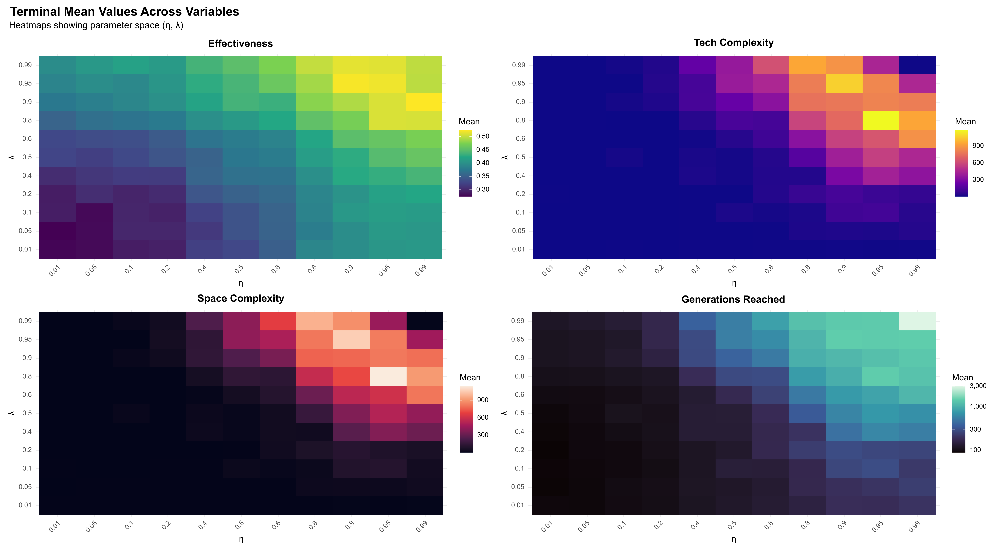

In [11]:
from IPython.display import Image,HTML,display
display(Image('terminal_mean.png',width=1000))
display(HTML('<i>Figure 1: Heatmaps showing mean values at simulation termination for effectiveness, complexity of technological systems, complexity of search spaces, and generations reached. The patterns reveal that open-ended growth requires moderate-to-strong selection pressures on both technological systems and search spaces.</i>'))

- $E(\mathbb{T},\mathbb{S})$: Mean terminal effectiveness shows a clear gradient from low values in the bottom-left corner where both parameters are highly stochastic ($\eta \approx \lambda \approx  0.01$) to moderately higher values in regions where at least one parameter exhibits a strong selection pressure (e.g., $\eta=0.99$). The highest effectiveness occurs when both parameters are strongly deterministic.
- $C_\mathbb{T}$: Mean complexity of technological systems shows a concentrated region of high values centered around $η = 0.8-0.9$ and $λ = 0.8-0.9$. Outside this region complexity drops dramatically to very low values. This pattern indicates that moderate-to-strong selection pressures on both technological systems and search spaces are necessary for sustained growth in complexity, but at the extreme growth is inhibited ($η = λ = 0.99$).
- $C_\mathbb{S}$: Search space complexity follows a similar pattern to $C_\mathbb{T}$, with a concentrated hotspot in the upper-right region of the parameter space.
- Generations Reached: The mean number of generations before termination shows that the probability of survival is maximised as both parameters approach the extreme of $\eta=\lambda=0.99$ (with a mean of $\approx 3060$ generations). A key point here is that regions with the longest survival are not strictly synonymous with $C_\mathbb{T}$ and $C_\mathbb{S}$, although the two are highly correlated with one another.

## Purely stochastic ($\eta=\lambda=0.0$) and purely deterministic ($\eta=\lambda=1.0$) runs

Special cases hold at the extremes of the parameter space: purely stochastic dynamics ($\eta=\lambda=0.0$) mean that technological systems and search spaces are solely driven by random changes and evolve independently of one another, while purely deterministic dynamics ($\eta=\lambda=1.0$) are entirely driven by selection for effectiveness and constitute a perfect co-evolutionary relationship. In the following, we first run combinations of parameters for these extremes, and then provide a brief overview of the main findings. 

### Simulation run code

In [60]:
# Simulation runs for extremes of eta and lambda
η_param = [0.0,1.0]
λ_param = [0.0,1.0]
sim_runs = {}
seed_index = 0
for η in η_param:
	for λ in λ_param:
		seeds = seed_gen(1000)
		for seed in seeds:
			print(f'Eta: {η}   Lamdba: {λ}   seed: {seed}')
			sim_runs.update({seed_index:simulation(
				seed=seed, # Set seed
				path="/your/path/here/", # Set path
				printing=False, # Print summary output at each generation
				write=False, # Write data to a .csv file
				limit=10000, # Upper-limit of technological complexity for simulation 
				generations=10000, # Total number of generations
				s_length=2, # Initial length of search space
				s_prob=None, # Initial probability of 0s and 1s for search space (default: None)
				t_length=2, # Initial length of technological system
				t_prob=None, # Initial probability of 0s and 1s for technological system (default: None)
				η=η, # Eta: Controls probability for type of change to technological systems. Maximally stochastic (η=0.0), Maximally deterministic (η=1.0)
				λ=λ, # Lambda: Controls probability for type of change to search spaces. Maximally stochastic (λ=0.0), Maximally deterministic (λ=1.0)
				initial_endowment=100.0, # The initial resource endowment for a society (default: 100)
				p_tradeoff=0.5 # Resource allocation tradeoff (default: 0.5)
			)})
			seed_index += 1


Eta: 0.0   Lamdba: 0.0   seed: 2975
2975 depleted resource store at generation 28. Final state: tech=5, space=2
Eta: 0.0   Lamdba: 0.0   seed: 4608
4608 depleted resource store at generation 119. Final state: tech=6, space=2
Eta: 0.0   Lamdba: 0.0   seed: 5160
5160 depleted resource store at generation 90. Final state: tech=6, space=3
Eta: 0.0   Lamdba: 0.0   seed: 9353
9353 depleted resource store at generation 134. Final state: tech=1, space=5
Eta: 0.0   Lamdba: 0.0   seed: 10843
10843 depleted resource store at generation 101. Final state: tech=3, space=4
Eta: 0.0   Lamdba: 0.0   seed: 11300
11300 depleted resource store at generation 119. Final state: tech=2, space=1
Eta: 0.0   Lamdba: 0.0   seed: 11432
11432 depleted resource store at generation 98. Final state: tech=1, space=3
Eta: 0.0   Lamdba: 0.0   seed: 13900
13900 depleted resource store at generation 86. Final state: tech=2, space=8
Eta: 0.0   Lamdba: 0.0   seed: 15853
15853 depleted resource store at generation 71. Final s

In [62]:
# Creating a single dataframe of simulation runs for plotting purposes
out = pd.concat([sim_runs[i] for i in sim_runs.keys()])
out = out.reset_index()
del out['index']
out # Displays pandas df 

,seed,generation,tech_complexity,space_complexity,effectiveness,initial_tech,initial_space,eta,lambda,initial_endowment,p_tradeoff,available_resources,resource_store
0,2975,0,2,2,0.500000,2,2,0.0,0.0,100.0,0.5,1.0,99.000000
1,2975,1,3,2,0.333333,2,2,0.0,0.0,100.0,0.5,1.0,98.000000
2,2975,2,4,2,0.250000,2,2,0.0,0.0,100.0,0.5,1.0,96.666667
3,2975,3,4,1,0.250000,2,2,0.0,0.0,100.0,0.5,1.0,94.166667
4,2975,4,4,1,0.250000,2,2,0.0,0.0,100.0,0.5,1.0,91.416667
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10406583,999703,9995,1,1,1.000000,2,2,1.0,1.0,100.0,0.5,1.0,94.000000
10406584,999703,9996,1,1,1.000000,2,2,1.0,1.0,100.0,0.5,1.0,94.000000
10406585,999703,9997,1,1,1.000000,2,2,1.0,1.0,100.0,0.5,1.0,94.000000
10406586,999703,9998,1,1,1.000000,2,2,1.0,1.0,100.0,0.5,1.0,94.000000


In [68]:
# Plotting function
def plot_sim(df, eta_value, lambda_value, metric):
	# Filter dataframe for the specified eta and lambda values
	filtered_df = df[(df['eta'] == eta_value) & (df['lambda'] == lambda_value)].copy()

	# Create the plot
	plt.figure(figsize=(12, 8))

	# Use seaborn lineplot with hue for different seeds
	ax = sns.lineplot(
		data=filtered_df,
		x='generation',
		y=metric,
		hue='seed',
		linewidth=1.5,
		alpha=0.8,
		legend=False
	)

	# Customise the plot
	plt.title(f'{metric.replace("_", " ").title()} over Generations\n(η={eta_value}, λ={lambda_value})', fontsize=14, pad=20)
	plt.xlabel('Generation', fontsize=12)
	plt.ylabel(metric.replace("_", " ").title(), fontsize=12)

	plt.grid(True, alpha=0.3, linestyle='--')

	plt.tight_layout()

	return plt.gcf(), ax

### $\eta=\lambda=0.0$

The plot below shows simulation runs when the dynamics are purely stochastic ($\eta=\lambda=0.0$) for $C_\mathbb{T}$. Without selection mechanisms to maintain effectiveness, the co-evolutionary dynamics are extremely volatile and collapse into an absorbing barrier relatively quickly. This condition represents a theoretical baseline for why sustainable co-evolutionary dynamics in our model require some selection for effectiveness. 

In [69]:
plot_sim(df=out, eta_value=0.0, lambda_value=0.0, metric='tech_complexity')

(<Figure size 864x576 with 1 Axes>,
 <AxesSubplot:title={'center':'Tech Complexity over Generations\n(η=0.0, λ=0.0)'}, xlabel='Generation', ylabel='Tech Complexity'>)

### $\eta=1.0$ and $\lambda=0.0$

When $\mathbb{T}$ is purely deterministic ($\eta=1.0$) and $\mathbb{S}$ is purely stochastic ($\lambda=0.0$), we observe a long-tailed distribution of simulation runs: the majority collapse into an absorbing barrier, but a small number survive for significantly longer (with a single run reaching the end of the simulation). This demonstrates that maximally powerful selection pressures on technological systems can overcome the stochastic perturbations of randomly evolving search spaces. Strong selection pressure on technological systems allows them to effectively track and exploit randomly changing search spaces, leading to both high effectiveness and the potential for sustained growth in complexity (albeit noisy).

(<Figure size 864x576 with 1 Axes>,
 <AxesSubplot:title={'center':'Tech Complexity over Generations\n(η=1.0, λ=0.0)'}, xlabel='Generation', ylabel='Tech Complexity'>)

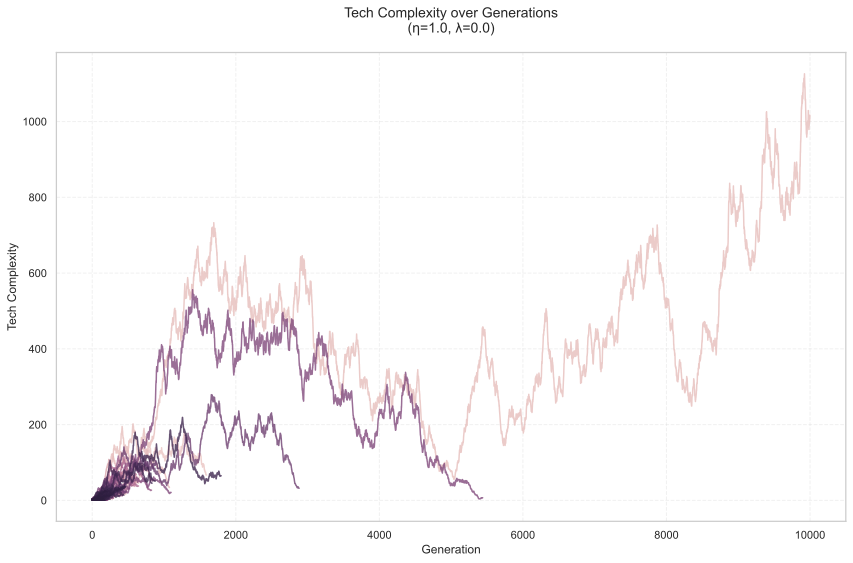

In [71]:
plot_sim(df=out, eta_value=1.0, lambda_value=0.0, metric='tech_complexity')

### $\eta=0.0$ and $\lambda=1.0$

In contrast to the previous section, inverting the pressures so that $\eta=0.0$ and $\lambda=1.0$ does not lead to comparable dynamics. Instead, the long-term survivability is greatly diminished, with zero runs reaching the end of the simulation and only one run was capable of exceeding $1750$ generations (see plot below). 

In [73]:
plot_sim(df=out, eta_value=0.0, lambda_value=1.0, metric='tech_complexity')

(<Figure size 864x576 with 1 Axes>,
 <AxesSubplot:title={'center':'Tech Complexity over Generations\n(η=0.0, λ=1.0)'}, xlabel='Generation', ylabel='Tech Complexity'>)

### $\eta=\lambda=1.0$

In a perfectly deterministic scenario ($\eta=\lambda=1.0$), we see that a significant portion of runs very quickly converge to a stable state and essentially halt for the remainder of the simulation. This traps societies with technological systems of relatively low complexity ($\max_{C_\mathbb{T}}=4$). As discussed in the main paper (for $\eta=\lambda=0.99$), we can think of this as a type of emergent local optima where $\mathbb{T}$ and $\mathbb{S}$ rapidly co-evolve toward one another and lead to long-term stasis. However, unlike $\eta=\lambda=0.99$, the absence of stochastic perturbations prevents escape from these equilibria. Below are two plots supporting our general points here. The first demonstrates how the dynamics become trapped in stable, low-complexity configurations for $\mathbb{T}$ of $C_\mathbb{T}=1$, $C_\mathbb{T}=2$, $C_\mathbb{T}=3$ and $C_\mathbb{T}=4$. The second shows that the cause of this stasis is due to effectiveness very rapidly reaching $E(\mathbb{T},\mathbb{S})=1.0$, i.e., there is no greater level effectiveness obtainable.

(<Figure size 864x576 with 1 Axes>,
 <AxesSubplot:title={'center':'Tech Complexity over Generations\n(η=1.0, λ=1.0)'}, xlabel='Generation', ylabel='Tech Complexity'>)

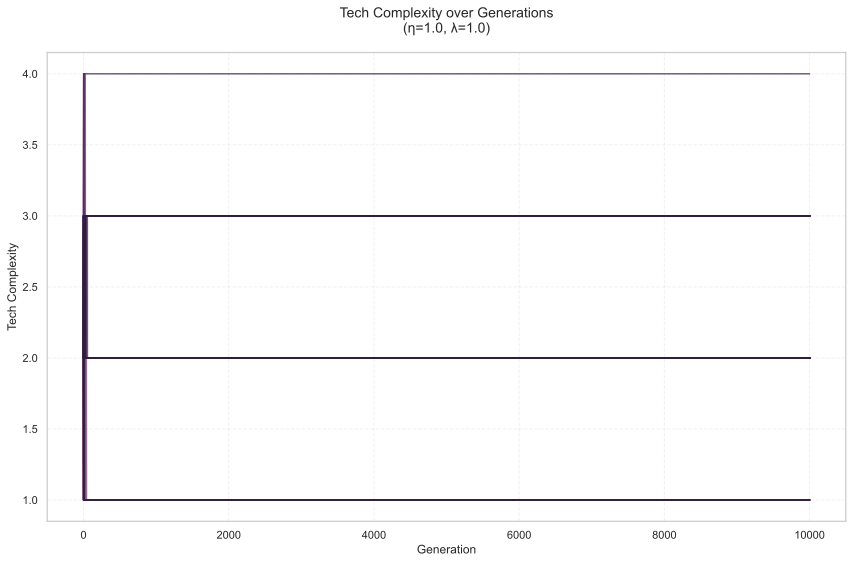

In [75]:
plot_sim(df=out, eta_value=1.0, lambda_value=1.0, metric='tech_complexity')

(<Figure size 864x576 with 1 Axes>,
 <AxesSubplot:title={'center':'Effectiveness over Generations\n(η=1.0, λ=1.0)'}, xlabel='Generation', ylabel='Effectiveness'>)

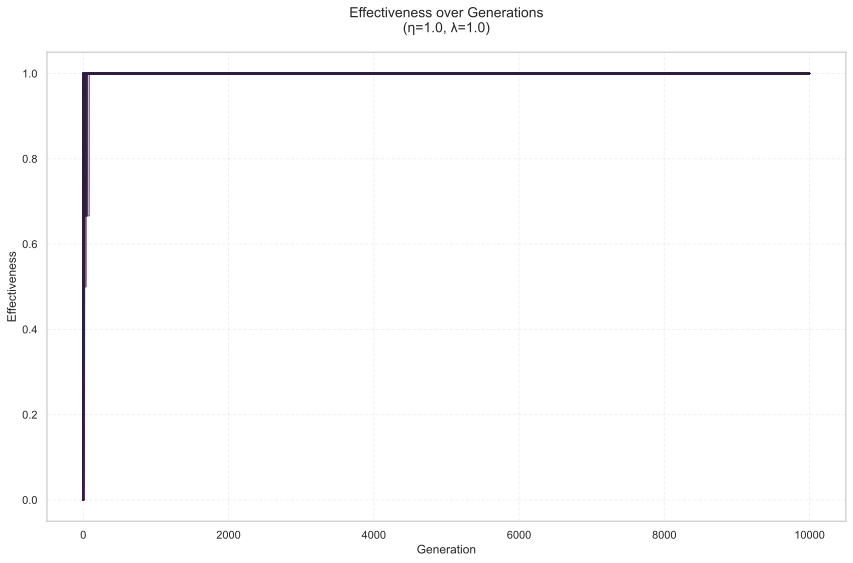

In [76]:
plot_sim(df=out, eta_value=1.0, lambda_value=1.0, metric='effectiveness')

### General summary

- **Asymmetric Selection Effects**: The comparison between $η = 1.0, λ = 0.0$ and $η = 0.0, λ = 1.0$ reveals a fundamental asymmetry in the model. Having strong selection pressures on technological systems ($η=1.0$ and $λ = 0.0$) is more effective at sustaining long-term co-evolution than the inverse scenario ($η=0.0$ and $λ = 1.0$). 
- **Purely deterministic leads to stasis and purely stochastic results in collapse**: The extreme conditions demonstrate that neither pure randomness ($\eta=\lambda=0.0$) nor perfect selection ($\eta=\lambda=1.0$) alone can sustain open-ended evolution. The model requires intermediate parameter values that balance stochastic perturbations with selective pressures to maintain far-from-equilibrium dynamics conducive to growth in complexity.
- **Resource constraints as fundamental inhibitors on open-ended evolution**: The highly curtailed sustainability of purely stochastic runs highlights the critical role of resource constraints in shaping co-evolutionary trajectories. Without a sustained production of resources, societies rapidly hit absorbing barriers even though they are provided with an initial resource endowment ($R_\text{endow}=100$).
- **Robustness-enhancing effects of complexity**: For the minority of runs that survive for extended periods (see $\eta=1.0, \lambda=0.0$), gains in complexity can enhance long-term sustainability when coupled with strong selection. Complex technological systems are more resilient to individual stochastic perturbations in search spaces because any single change represents a proportionally smaller disruption to overall effectiveness.

## Different initial resource endowments ($R_\text{endow}$)

In the main paper, we only considered resources endowments of $R_\text{endow}=100$. However, we can consider a series of counterfactual scenarios with lower resource endowments, which provides us with information about the survivability of the same simulation runs under different initial endowments (see [counterfactual.R](https://github.com/j-winters/bitw0r1d/blob/main/supplementary/counterfactual.R) for R code). Below, we systematically vary initial endowments across five levels, $R_\text{endow} \in [1, 25, 50, 75, 100]$, and produce heatmaps for $C_\mathbb{T}$ at point of termination and mean number of generations reached:

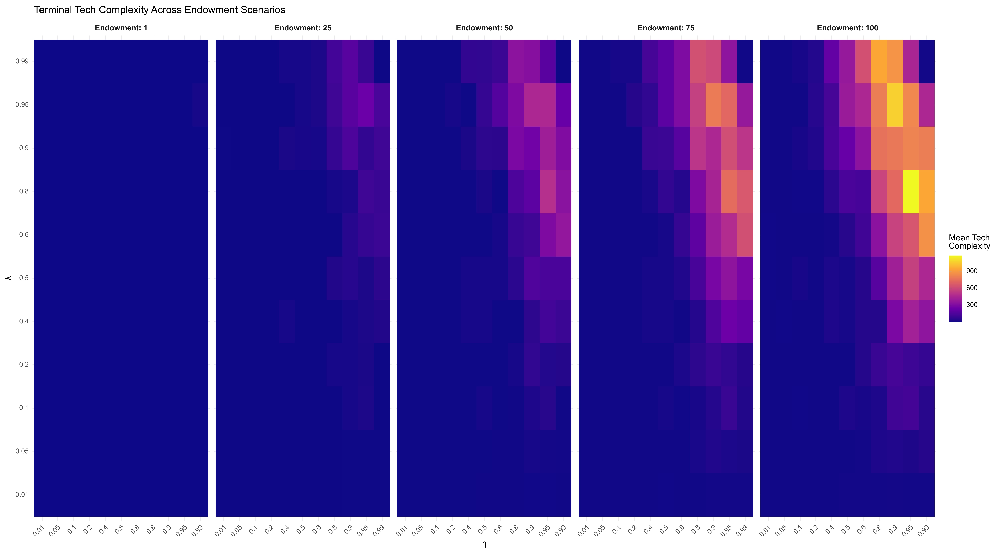

In [12]:
display(Image('endow_complexity.png',width=1000))
display(HTML('<i>Heatmaps showing mean complexity of technological systems achieved at termination points of simulation runs across different initial resource endowments. Each panel represents the parameter space with η (selection pressure on technological systems) on the x-axis and λ (selection pressure on search spaces) on the y-axis. Color intensity indicates mean technological complexity, with darker blue representing lower complexity and brighter yellow representing higher complexity.</i>'))

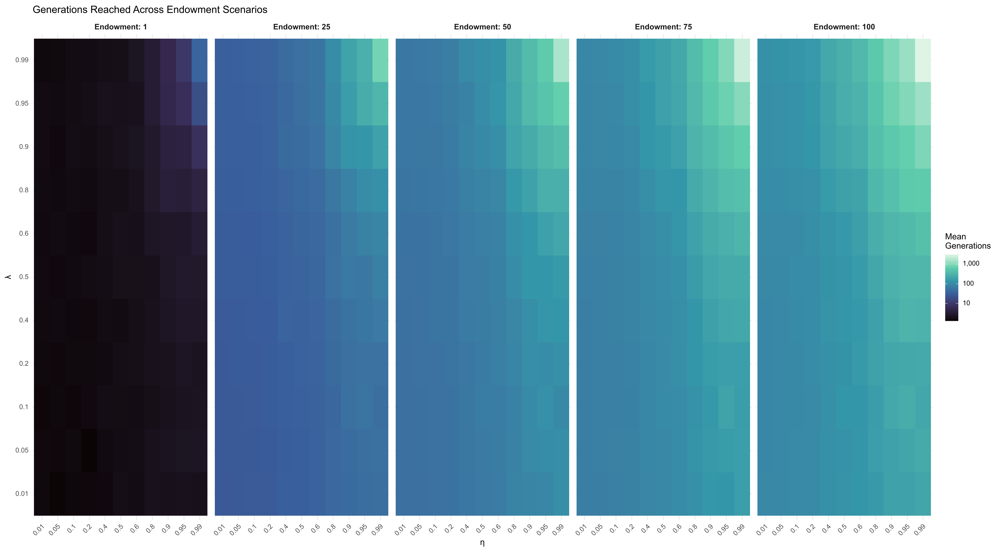

In [15]:
display(Image('endow_generations.png',width=1000))
display(HTML('<i>Heatmaps showing mean generations survived before termination across different initial resource endowments. Each panel represents the parameter space with η (selection pressure on technological systems) on the x-axis and λ (selection pressure on search spaces) on the y-axis. Color intensity indicates mean survival duration, with darker colors representing shorter survival and brighter colors representing longer survival.</i>'))

Under severely constrained initial conditions ($R_\text{endow}=1$), the co-evolutionary dynamics collapse across virtually the entire parameter space. Both technological complexity and survival times remain uniformly low regardless of $\eta$ and $\lambda$. Only when selection pressures are extremely powerful, i.e., $\eta \rightarrow 1.0$ and $\lambda \rightarrow 1.0$, do we observe instances of sustainable co-evolutionary dynamics in the long-term. On average, increasing the initial endowment generally leads to higher levels of sustainability and greater levels of complexity 